<a href="https://colab.research.google.com/github/AjibolaPy/PaViT/blob/main/PaViTNBs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [39]:
from tensorflow.keras.layers import *
import pandas as pd
import numpy as np
from tensorflow.keras.models import *
from keras.optimizers import Adam
import sys
import os
from random import *
sys.path.append(os.path.abspath('/content'))
import new_pavit
import PaViTs
import cv2
import tensorflow as tf
from keras.callbacks import *
from tensorflow.keras.utils import to_categorical
from keras.preprocessing.text import Tokenizer
from sklearn.preprocessing import LabelBinarizer, MultiLabelBinarizer
import matplotlib.pyplot as plt
from keras.activations import *
from tensorflow.keras.metrics import *
from keras.preprocessing.image import *
import tensorflow as tf
from tensorflow.image import extract_patches
import warnings
warnings.filterwarnings('ignore')

In [2]:
try:
  import opendatasets
  
except:
  !pip install opendatasets
  import opendatasets
opendatasets.download('https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset')



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: ajibolaemmanuel
Your Kaggle Key: ··········


100%|██████████| 534M/534M [00:24<00:00, 22.6MB/s]


In [ ]:
#|img=plt.imread('C:\\Users\\Emmanuel\\Music\\download.png')
#img=cv2.resize(img, (224, 224))
num_patches=224//32

In [5]:
traingen=ImageDataGenerator(rescale=1/224, height_shift_range=.2, 
                            horizontal_flip=True, vertical_flip=True,
                            rotation_range=.3)
train_data=traingen.flow_from_directory(directory='/content/vegetable-image-dataset/Vegetable Images/train',
                                        target_size=(224, 224), batch_size=100,shuffle=True,class_mode='categorical', color_mode='rgb')


valgen=ImageDataGenerator(rescale=1/224, height_shift_range=.2, 
                            horizontal_flip=True, vertical_flip=True,
                            rotation_range=.3)
val_data=valgen.flow_from_directory(directory='/content/vegetable-image-dataset/Vegetable Images/validation',
                                        target_size=(224, 224), batch_size=100,shuffle=True,class_mode='categorical', color_mode='rgb')

Found 15000 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.


In [6]:
#classes={i:j for i, v in range(1)}

<Figure size 432x288 with 0 Axes>

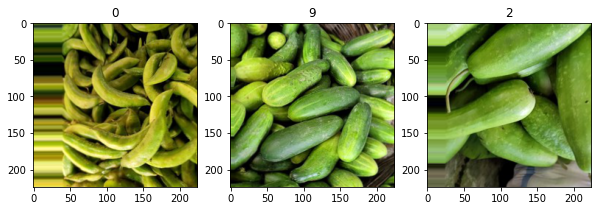

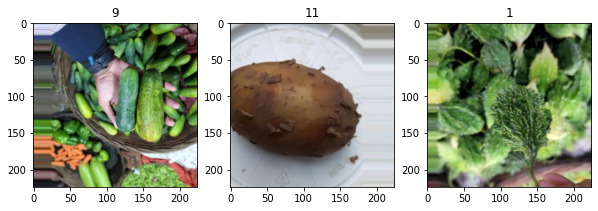

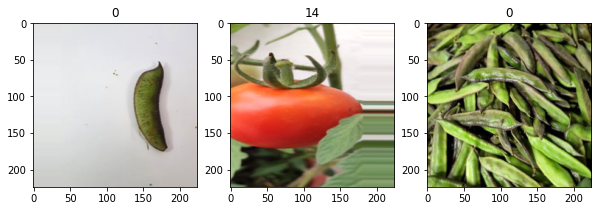

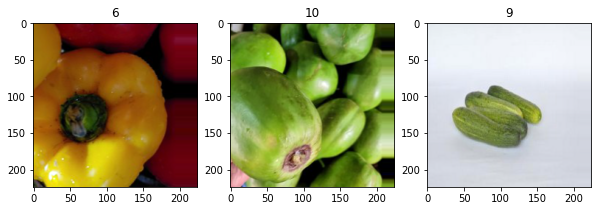

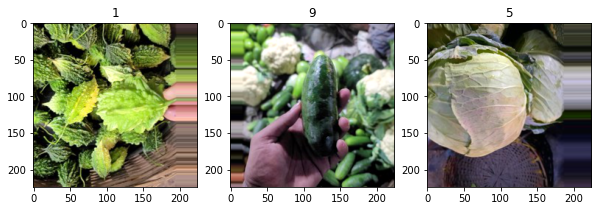

In [7]:
def show_Data(data, suptitle: str, fig_size:tuple=(10, 10)):
    plt.suptitle(suptitle)
    fig=plt.figure(figsize=fig_size)
    for i in range(3):
        x, y=next(iter(data))
        seeds=randint(0, 100-1)
        fig.add_subplot(1, 3, i+1)
        plt.imshow(x[seeds])
        plt.title(np.argmax(y[seeds], axis=-1))
        

        
for i in range(5):
    show_Data(train_data, suptitle=None)
        

In [14]:
model=PaViTs.PaViT(num_heads=14, mlp_it=10)
p_model=model.model(activation='softmax')
p_model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input (InputLayer)             [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.image.extract_patches_3 (TF  (None, 7, 7, 3072)  0           ['Input[0][0]']                  
 OpLambda)                                                                                        
                                                                                                  
 reshape_3 (Reshape)            (None, 49, 3072)     0           ['tf.image.extract_patches_3[0][0
                                                                 ]']                        

In [15]:
p_model.compile(loss='categorical_crossentropy', optimizer=Adam(1e-3), metrics=['accuracy',Precision(), Recall() ])
es=EarlyStopping(mode='min', monitor='val_loss', patience=5, restore_best_weights=True)
rl=ReduceLROnPlateau(mode='min', monitor='val_loss',patience=3, min_lr=1e-8)
cp=ModelCheckpoint('PAVIT_weight.h5', monitor='val_loss', save_best_only=True)
history=p_model.fit(train_data, epochs=50, batch_size=1, callbacks=[rl, es, cp], validation_data=val_data)

Epoch 1/50
150/150 [==============================] - 207s 1s/step - loss: 1.8669 - accuracy: 0.4424 - precision_1: 0.5917 - recall_1: 0.3081 - val_loss: 2.8471 - val_accuracy: 0.3360 - val_precision_1: 0.4179 - val_recall_1: 0.2933 - lr: 0.0010
Epoch 2/50
150/150 [==============================] - 203s 1s/step - loss: 1.0417 - accuracy: 0.6747 - precision_1: 0.7610 - recall_1: 0.5839 - val_loss: 2.0416 - val_accuracy: 0.4973 - val_precision_1: 0.5578 - val_recall_1: 0.4407 - lr: 0.0010
Epoch 3/50
150/150 [==============================] - 201s 1s/step - loss: 0.6194 - accuracy: 0.8019 - precision_1: 0.8509 - recall_1: 0.7578 - val_loss: 0.9620 - val_accuracy: 0.7503 - val_precision_1: 0.7875 - val_recall_1: 0.7240 - lr: 0.0010
Epoch 5/50
150/150 [==============================] - 202s 1s/step - loss: 0.5218 - accuracy: 0.8373 - precision_1: 0.8730 - recall_1: 0.8034 - val_loss: 0.5801 - val_accuracy: 0.8243 - val_precision_1: 0.8556 - val_recall_1: 0.7980 - lr: 0.0010
Epoch 6/50
150/1

In [ ]:
p_model.history.history

<ipython-input-32-864d18796635>:15: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  fig.add_subplot(1,3, 2)
<ipython-input-32-864d18796635>:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  fig.add_subplot(1,3, 1)


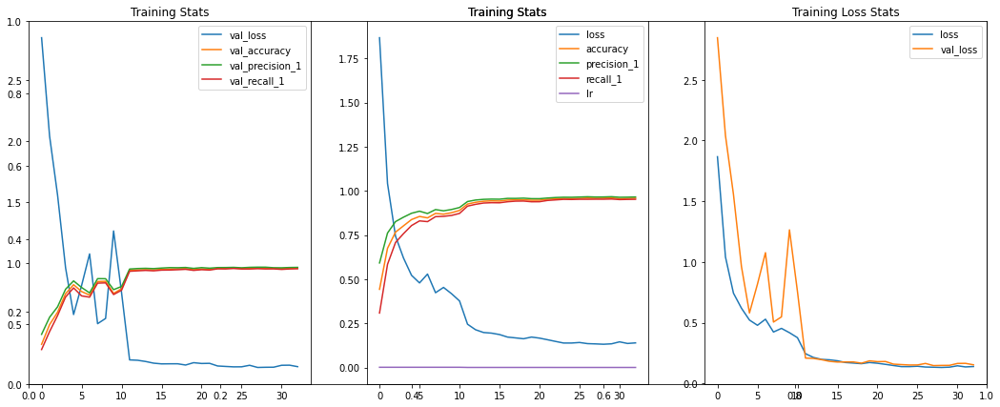

In [32]:
fig=plt.figure(figsize=(18, 7))
val=[]
non_val=[]
for i in p_model.history.history:
    if i.startswith('val'):
        fig.add_subplot(1,3, 1)
        plt.title('Training Validation Stats')
        plt.plot(p_model.history.history[i])
        non_val.append(i)
        plt.legend(non_val)

    else:
        if not i.startswith('val'):
            plt.title('Training Stats')
            fig.add_subplot(1,3, 2)
            plt.plot(p_model.history.history[i])
            val.append(i)
            plt.legend(val)
fig.add_subplot(1,3, 3)
plt.title('Training Loss Stats')
plt.plot(p_model.history.history['loss'])
plt.plot(p_model.history.history['val_loss'])
plt.legend(['loss', 'val_loss'])
plt.show()

In [38]:
p_model.evaluate(test_data)

30/30 [==============================] - 8s 255ms/step - loss: 0.1090 - accuracy: 0.9717 - precision_1: 0.9748 - recall_1: 0.9687


[0.10901572555303574, 0.971666693687439, 0.9748406410217285, 0.968666672706604]

In [33]:
testgen=ImageDataGenerator(rescale=1/224)
test_data=testgen.flow_from_directory(directory='vegetable-image-dataset/Vegetable Images/test',
                                        target_size=(224, 224), batch_size=100,shuffle=True,class_mode='categorical', color_mode='rgb')


Found 3000 images belonging to 15 classes.


In [34]:
p_model.evaluate(test_data)

30/30 [==============================] - 7s 240ms/step - loss: 0.1090 - accuracy: 0.9717 - precision_1: 0.9748 - recall_1: 0.9687


[0.10901572555303574, 0.971666693687439, 0.9748406410217285, 0.968666672706604]

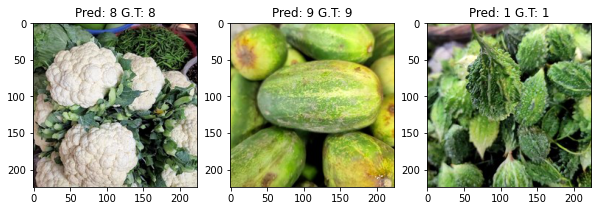

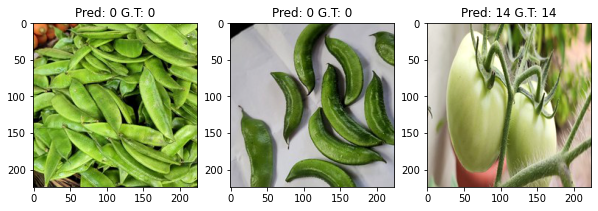

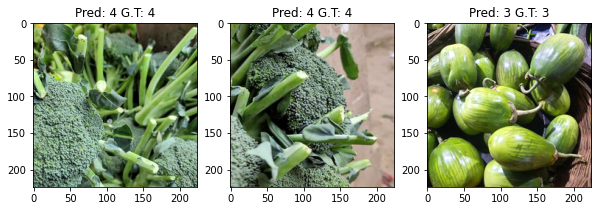

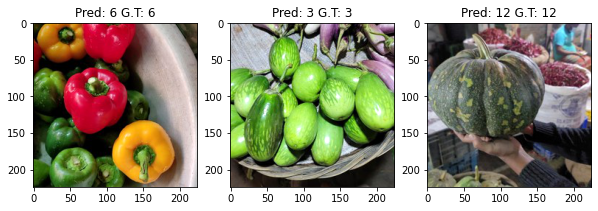

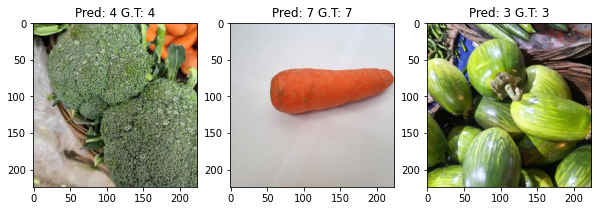

...

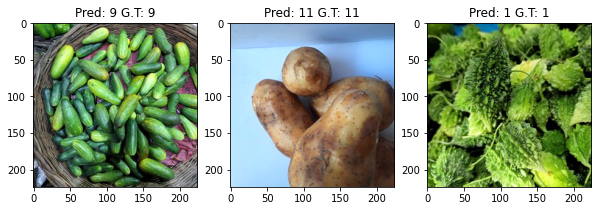

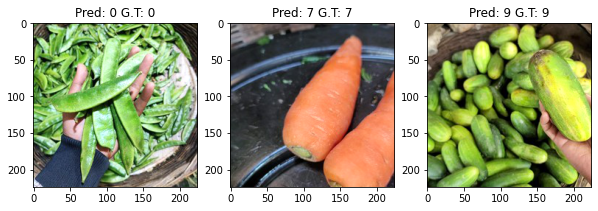

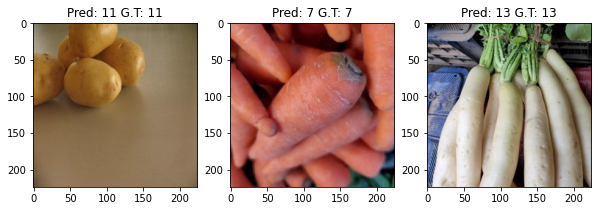

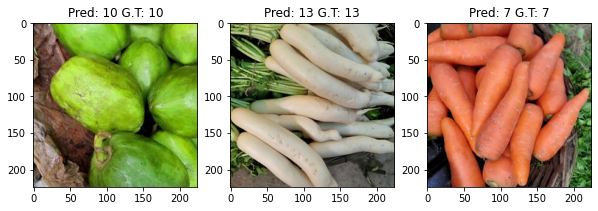

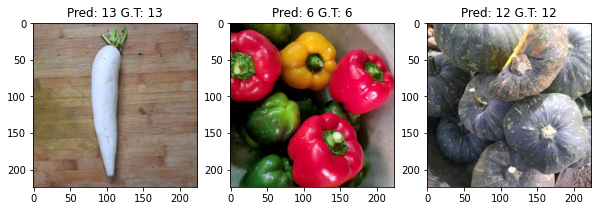

In [40]:
def show(test):
    
    x, y= next(iter(test))
    fig=plt.figure(figsize=(15, 11))
    for i in range(3):
        fig.add_subplot(1,3,i+1)
        n=randint(0, 99)
        plt.imshow(x[n])
        pred=p_model(np.expand_dims(x[n], axis=0))
        pred=np.argmax(pred, axis=-1)
        plt.title(f'Pred: {int(pred)} G.T: {np.argmax(y[n], axis=-1)}')

for i in range(100):
    show(test_data)